In [1]:
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive
%cd /mydrive/Hugging Face
!ls

Mounted at /content/gdrive
/content/gdrive/My Drive/Hugging Face
best_vitpose_model		   output
datasets			   RTDETR_Huggingface_det_train.ipynb
DeepLabv3+_Seg.ipynb		   SegFormer_Huggingface_seg_train.ipynb
Detectron2_MaskRCNN_Seg.ipynb	   segformer_trained_weights
EfficientNet_classify.ipynb	   segformer_trained_weights_47
markerpensseg			   ViT_Huggingface_classify.ipynb
Markerpens_seg			   vit-multilabel-best
mask2former_Huggingface_seg.ipynb  ViTPose_Huggingface_keypoints.ipynb
mask2formerresults		   YOLOS_Huggingface_det.ipynb
mydrive				   YOLOS_Huggingface_det_wandb.ipynb


In [ ]:
import os
import json

def count_images(image_dir, exts={".jpg", ".jpeg", ".png", ".bmp", ".webp"}):
    image_count = 0
    for filename in os.listdir(image_dir):
        if os.path.splitext(filename.lower())[1] in exts:
            image_count += 1
    print(f"Total images: {image_count}")

count_images("datasets/surgical_instruments/images/train")
count_images("datasets/surgical_instruments/images/valid")

Total images: 2855
Total images: 841


In [ ]:
# Check train annotations
with open("datasets/surgical_instruments/annotations/instances_train.json") as f:
    train_data = json.load(f)
    print(f"Train images: {len(train_data['images'])}")
    print(f"Train annotations: {len(train_data['annotations'])}")
    print(f"Categories: {train_data['categories']}")

# Check validation
with open("datasets/surgical_instruments/annotations/instances_valid.json") as f:
    valid_data = json.load(f)
    print(f"\nValid images: {len(valid_data['images'])}")
    print(f"Valid annotations: {len(valid_data['annotations'])}")

Train images: 2855
Train annotations: 4895
Categories: [{'id': 1, 'name': 'Grasper'}, {'id': 2, 'name': 'Harmonic_Ace'}, {'id': 3, 'name': 'Myoma_Screw'}, {'id': 4, 'name': 'Needle_Holder'}, {'id': 5, 'name': 'Suction'}, {'id': 6, 'name': 'Trocar'}]

Valid images: 841
Valid annotations: 1215


In [ ]:
import json
from collections import defaultdict
from pprint import pprint

def check_coco_instance_segmentation(ann_file_path):
    with open(ann_file_path, 'r') as f:
        coco_data = json.load(f)

    # Top-level keys
    assert 'images' in coco_data, "'images' key not found"
    assert 'annotations' in coco_data, "'annotations' key not found"
    assert 'categories' in coco_data, "'categories' key not found"

    print(f"📷 Total images: {len(coco_data['images'])}")
    print(f"✏️ Total annotations: {len(coco_data['annotations'])}")
    print(f"🏷️ Total categories: {len(coco_data['categories'])}")

    print("\n🔍 Sample category definitions:")
    pprint(coco_data['categories'])

    # Required annotation fields
    required_fields = {"id", "image_id", "bbox", "category_id", "segmentation"}
    optional_fields = ["iscrowd", "area"]
    missing_fields = defaultdict(list)
    bad_segmentations = []

    for i, ann in enumerate(coco_data['annotations']):
        for field in required_fields:
            if field not in ann:
                missing_fields[field].append(i)

        # Check segmentation format: must be non-empty polygon(s)
        seg = ann.get("segmentation", [])
        if not isinstance(seg, list) or len(seg) == 0:
            bad_segmentations.append((i, "Empty or invalid segmentation"))
        else:
            for poly in seg:
                if not isinstance(poly, list) or len(poly) < 6 or len(poly) % 2 != 0:
                    bad_segmentations.append((i, f"Invalid polygon: {poly}"))

    # Report missing fields
    for field, indices in missing_fields.items():
        print(f"⚠️ Missing '{field}' in {len(indices)} annotations. Examples: {indices[:5]}")
    if not missing_fields:
        print("✅ All required fields are present in every annotation")

    # Report segmentation issues
    if bad_segmentations:
        print(f"⚠️ Found {len(bad_segmentations)} invalid/malformed segmentations.")
        for i, reason in bad_segmentations[:5]:
            print(f"  Annotation {i}: {reason}")
    else:
        print("✅ All segmentations are well-formed polygons")

    # Optional fields
    for field in optional_fields:
        missing = sum(1 for ann in coco_data['annotations'] if field not in ann)
        if missing > 0:
            print(f"⚠️ Missing optional '{field}' in {missing} annotations")
        else:
            print(f"✅ All annotations have optional field '{field}'")

# Example usage:
check_coco_instance_segmentation("datasets/surgical_instruments/annotations/instances_train.json")

📷 Total images: 2855
✏️ Total annotations: 4895
🏷️ Total categories: 6

🔍 Sample category definitions:
[{'id': 1, 'name': 'Grasper'},
 {'id': 2, 'name': 'Harmonic_Ace'},
 {'id': 3, 'name': 'Myoma_Screw'},
 {'id': 4, 'name': 'Needle_Holder'},
 {'id': 5, 'name': 'Suction'},
 {'id': 6, 'name': 'Trocar'}]
✅ All required fields are present in every annotation
✅ All segmentations are well-formed polygons
✅ All annotations have optional field 'iscrowd'
✅ All annotations have optional field 'area'


In [ ]:
import json
import os
from pathlib import Path
import numpy as np
from PIL import Image
from pycocotools import mask as maskUtils

def convert_instance_to_semantic(coco_json_path, images_dir, output_mask_dir, class_ids=None):
    with open(coco_json_path) as f:
        coco = json.load(f)

    os.makedirs(output_mask_dir, exist_ok=True)
    images = {img["id"]: img for img in coco["images"]}
    annotations = coco["annotations"]

    # Initialize empty masks
    semantic_masks = {}

    for ann in annotations:
        image_id = ann["image_id"]
        category_id = ann["category_id"]

        if class_ids and category_id not in class_ids:
            continue

        img_info = images[image_id]
        img_name = img_info["file_name"]
        img_path = os.path.join(images_dir, img_name)
        width, height = img_info["width"], img_info["height"]

        if img_name not in semantic_masks:
            semantic_masks[img_name] = np.zeros((height, width), dtype=np.uint8)

        # Convert segmentation to binary mask
        rle = maskUtils.frPyObjects(ann['segmentation'], height, width)
        mask = maskUtils.decode(rle)
        mask = np.any(mask, axis=2).astype(np.uint8)  # Merge if multiple segments

        # Fill class ID into mask
        semantic_masks[img_name][mask == 1] = category_id

    # Save all masks as PNG
    for img_name, mask in semantic_masks.items():
        mask_img = Image.fromarray(mask)
        mask_img.save(os.path.join(output_mask_dir, Path(img_name).stem + ".png"))

    print(f"✅ Saved {len(semantic_masks)} semantic masks to {output_mask_dir}")

In [ ]:
convert_instance_to_semantic(
    coco_json_path='datasets/surgical_instruments/annotations/instances_train.json',
    images_dir='datasets/surgical_instruments/images/train',
    output_mask_dir='datasets/surgical_instruments/semantic_masks/train',
    class_ids=[1, 2, 3, 4, 5, 6]  # optional
)

✅ Saved 2696 semantic masks to datasets/surgical_instruments/semantic_masks/train


In [ ]:
convert_instance_to_semantic(
    coco_json_path='datasets/surgical_instruments/annotations/instances_valid.json',
    images_dir='datasets/surgical_instruments/images/valid',
    output_mask_dir='datasets/surgical_instruments/semantic_masks/valid',
    class_ids=[1, 2, 3, 4, 5, 6]
)

✅ Saved 815 semantic masks to datasets/surgical_instruments/semantic_masks/valid


In [ ]:
!pip install segmentation-models-pytorch albumentations

In [3]:
import segmentation_models_pytorch as smp
import matplotlib.pyplot as plt
import cv2
import os
import torch
from PIL import Image
import numpy as np
from torch.utils.data import Dataset
import torch.nn.functional as F
import torchvision.transforms as T
import albumentations as A
from albumentations.pytorch import ToTensorV2

NUM_CLASSES = 7  # 6 tools + background
ENCODER = "resnet101"
ENCODER_WEIGHTS = "imagenet"
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

In [4]:
class SemanticSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform

        image_files = sorted(os.listdir(image_dir))
        mask_files = sorted(os.listdir(mask_dir))

        # Extract stems without extension
        image_stems = {os.path.splitext(f)[0] for f in image_files}
        mask_stems = {os.path.splitext(f)[0] for f in mask_files}

        # Keep only images with matching masks
        common_stems = sorted(image_stems.intersection(mask_stems))

        # Build final file lists
        self.images = [f + ".jpg" for f in common_stems]  # adjust extension if needed
        self.masks = [f + ".png" for f in common_stems]

        print(f"Loaded {len(self.images)} images with masks.")

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])

        image = np.array(Image.open(img_path).convert("RGB"))
        mask = np.array(Image.open(mask_path))

        if self.transform:
            augmented = self.transform(image=image, mask=mask)
            image = augmented['image']
            mask = augmented['mask']

            if not torch.is_tensor(mask):
                mask = torch.tensor(mask, dtype=torch.long)
            else:
                mask = mask.long()
        else:
            image = torch.tensor(image.transpose(2, 0, 1), dtype=torch.float32) / 255.0
            mask = torch.tensor(mask, dtype=torch.long)

        return image, mask

def get_training_augmentations():
    return A.Compose([
        A.Resize(512, 512),  # or other size you want (e.g. 256,256)
        A.HorizontalFlip(p=0.5),
        A.RandomBrightnessContrast(p=0.2),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ])

def get_validation_augmentations():
    return A.Compose([
        A.Resize(512, 512),  # same size as training
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ])

In [5]:
import torch.nn as nn
import segmentation_models_pytorch as smp
from segmentation_models_pytorch.utils import metrics

class CombinedLoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.dice = smp.losses.DiceLoss(mode="multiclass")
        self.ce = nn.CrossEntropyLoss()

    def forward(self, pred, target):
        return self.dice(pred, target) + self.ce(pred, target)

    @property
    def __name__(self):
        return "CombinedLoss"

loss_fn = CombinedLoss()

In [6]:
import torch

import torch

class WrappedIoU:
    def __init__(self, num_classes=7):
        self.num_classes = num_classes
        self.__name__ = "iou_score"

    def __call__(self, outputs, targets):
        preds = torch.argmax(outputs, dim=1)  # [B, H, W]
        ious = []
        for cls in range(self.num_classes):
            pred_inds = (preds == cls)
            target_inds = (targets == cls)
            intersection = (pred_inds & target_inds).sum().item()
            union = (pred_inds | target_inds).sum().item()
            if union == 0:
                continue
            iou = intersection / union
            ious.append(iou)
        return torch.tensor(ious).mean() if ious else torch.tensor(0.0)

    def to(self, device):
        # Required for compatibility with SMP's TrainEpoch
        return self

metrics = [WrappedIoU(num_classes=7)]

In [ ]:
model = smp.DeepLabV3Plus(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    in_channels=3,
    classes=NUM_CLASSES,
).to(DEVICE)

In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

In [7]:
from torch.utils.data import DataLoader

train_dataset = SemanticSegmentationDataset(
    image_dir='datasets/surgical_instruments/images/train',
    mask_dir='datasets/surgical_instruments/semantic_masks/train',
    transform=get_training_augmentations()
)

valid_dataset = SemanticSegmentationDataset(
    image_dir='datasets/surgical_instruments/images/valid',
    mask_dir='datasets/surgical_instruments/semantic_masks/valid',
    transform=get_validation_augmentations()
)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=4, shuffle=False, num_workers=2)

/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


Loaded 2696 images with masks.
Loaded 815 images with masks.


In [ ]:
train_epoch = smp.utils.train.TrainEpoch(
    model,
    loss=loss_fn,          # your CombinedLoss
    metrics=metrics,  # IoU, F1
    optimizer=optimizer,
    device=DEVICE,
    verbose=False,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss_fn,
    metrics=metrics,
    device=DEVICE,
    verbose=False,
)

In [ ]:
max_epochs = 25
best_iou = 0

for epoch in range(max_epochs):
    print(f"\n📆 Epoch {epoch+1}/{max_epochs}")

    train_logs = train_epoch.run(train_loader)
    valid_logs = valid_epoch.run(valid_loader)

    print(f"📉 Train Loss: {train_logs['CombinedLoss']:.4f} | IoU: {train_logs['iou_score']:.4f}")
    print(f"🧪 Val   Loss: {valid_logs['CombinedLoss']:.4f} | IoU: {valid_logs['iou_score']:.4f}")

    if valid_logs['iou_score'] > best_iou:
        best_iou = valid_logs['iou_score']
        torch.save(model.state_dict(), 'datasets/best_deeplabv3plus.pth')
        print("💾 Saved best model!")


📆 Epoch 1/25
📉 Train Loss: 0.1745 | IoU: 0.6621
🧪 Val   Loss: 0.1393 | IoU: 0.6258
💾 Saved best model!

📆 Epoch 2/25
📉 Train Loss: 0.1434 | IoU: 0.6965
🧪 Val   Loss: 0.1553 | IoU: 0.5759

📆 Epoch 3/25
📉 Train Loss: 0.1462 | IoU: 0.7026
🧪 Val   Loss: 0.1357 | IoU: 0.6455
💾 Saved best model!

📆 Epoch 4/25
📉 Train Loss: 0.1253 | IoU: 0.7290
🧪 Val   Loss: 0.1251 | IoU: 0.6054

📆 Epoch 5/25
📉 Train Loss: 0.1128 | IoU: 0.7579
🧪 Val   Loss: 0.1392 | IoU: 0.5763

📆 Epoch 6/25
📉 Train Loss: 0.1165 | IoU: 0.7409
🧪 Val   Loss: 0.1268 | IoU: 0.6720
💾 Saved best model!

📆 Epoch 7/25
📉 Train Loss: 0.1046 | IoU: 0.7716
🧪 Val   Loss: 0.1044 | IoU: 0.6619

📆 Epoch 8/25
📉 Train Loss: 0.1005 | IoU: 0.7800
🧪 Val   Loss: 0.1369 | IoU: 0.6347

📆 Epoch 9/25
📉 Train Loss: 0.0878 | IoU: 0.8020
🧪 Val   Loss: 0.1061 | IoU: 0.6650

📆 Epoch 10/25
📉 Train Loss: 0.0791 | IoU: 0.8222
🧪 Val   Loss: 0.1248 | IoU: 0.6362

📆 Epoch 11/25
📉 Train Loss: 0.0812 | IoU: 0.8197
🧪 Val   Loss: 0.1321 | IoU: 0.6656

📆 Epoch 12/25

In [9]:
# Define the model architecture again
model = smp.DeepLabV3Plus(
    encoder_name="resnet101",  # or whatever you used
    classes=7,
    activation=None
)

# Load weights
model.load_state_dict(torch.load('datasets/best_deeplabv3plus.pth'))
model = model.to(DEVICE)
model.eval()

DeepLabV3Plus(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequentia

In [10]:
import numpy as np
import torch

def update_confusion_matrix(preds, targets, num_classes):
    cm = np.zeros((num_classes, 2, 2))  # For each class: TP, FP, FN, TN

    preds = torch.argmax(preds, dim=1).cpu().numpy()
    targets = targets.cpu().numpy()

    for cls in range(num_classes):
        pred_cls = preds == cls
        target_cls = targets == cls

        intersection = np.logical_and(pred_cls, target_cls).sum()
        union = np.logical_or(pred_cls, target_cls).sum()

        if union > 0:
            cm[cls, 0, 0] += intersection  # TP
            cm[cls, 0, 1] += pred_cls.sum() - intersection  # FP
            cm[cls, 1, 0] += target_cls.sum() - intersection  # FN

    return cm

def print_segmentation_metrics(conf_matrix, class_names, ignore_background=True):
    num_classes = len(class_names)
    print("\n📊 Per-Class Metrics:")

    start_idx = 1 if ignore_background else 0

    for i in range(start_idx, num_classes):
        tp = conf_matrix[i, 0, 0]
        fp = conf_matrix[i, 0, 1]
        fn = conf_matrix[i, 1, 0]

        precision = tp / (tp + fp) if (tp + fp) > 0 else float('nan')
        recall = tp / (tp + fn) if (tp + fn) > 0 else float('nan')
        f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else float('nan')

        print(f"{class_names[i]:<15}: "
              f"Precision = {precision:.4f}, "
              f"Recall = {recall:.4f}, "
              f"F1 = {f1:.4f}")

# Initialize
num_classes = 7
conf_matrix = np.zeros((num_classes, 2, 2))

model.eval()
with torch.no_grad():
    for images, masks in valid_loader:
        images, masks = images.to(DEVICE), masks.to(DEVICE)
        outputs = model(images)

        conf_matrix += update_confusion_matrix(outputs, masks, num_classes)

# Calculate per-class IoU
print("\n📊 Per-Class IoU:")
class_names = [
    "Background",
    "Grasper",
    "Harmonic_Ace",
    "Myoma_Screw",
    "Needle_Holder",
    "Suction",
    "Trocar"
]

for i in range(num_classes):
    tp = conf_matrix[i, 0, 0]
    fp = conf_matrix[i, 0, 1]
    fn = conf_matrix[i, 1, 0]

    denom = tp + fp + fn
    iou = tp / denom if denom > 0 else float('nan')
    print(f"{class_names[i]:<15}: IoU = {iou:.4f}" if not np.isnan(iou) else f"{class_names[i]:<15}: IoU = N/A")

print_segmentation_metrics(conf_matrix, class_names, ignore_background=False)


📊 Per-Class IoU:
Background     : IoU = 0.9943
Grasper        : IoU = 0.7772
Harmonic_Ace   : IoU = 0.7662
Myoma_Screw    : IoU = 0.8263
Needle_Holder  : IoU = 0.7890
Suction        : IoU = 0.5736
Trocar         : IoU = 0.8359

📊 Per-Class Metrics:
Background     : Precision = 0.9972, Recall = 0.9971, F1 = 0.9972
Grasper        : Precision = 0.8738, Recall = 0.8755, F1 = 0.8746
Harmonic_Ace   : Precision = 0.8227, Recall = 0.9178, F1 = 0.8676
Myoma_Screw    : Precision = 0.8907, Recall = 0.9196, F1 = 0.9049
Needle_Holder  : Precision = 0.8576, Recall = 0.9079, F1 = 0.8820
Suction        : Precision = 0.9122, Recall = 0.6071, F1 = 0.7290
Trocar         : Precision = 0.9303, Recall = 0.8917, F1 = 0.9106


In [14]:
# Define class names and color map (BGR or RGB as you like)
class_names = [
    "Background", "Grasper", "Harmonic_Ace", "Myoma_Screw",
    "Needle_Holder", "Suction", "Trocar"
]

# Assign distinct colors per class (R, G, B)
class_colors = {
    0: (0, 0, 0),          # background - black
    1: (255, 0, 0),        # red
    2: (0, 255, 0),        # green
    3: (0, 0, 255),        # blue
    4: (255, 255, 0),      # yellow
    5: (255, 0, 255),      # magenta
    6: (0, 255, 255),      # cyan
}
# Default mean and std for normalization (ImageNet)
_default_mean = (0.485, 0.456, 0.406)
_default_std = (0.229, 0.224, 0.225)

In [15]:
def mask_to_color(mask):
    h, w = mask.shape
    color_mask = np.zeros((h, w, 3), dtype=np.uint8)
    for cls_id, color in class_colors.items():
        color_mask[mask == cls_id] = color
    return color_mask

def pad_to_divisible(img_tensor, divisor=16):
    _, _, h, w = img_tensor.shape
    pad_h = (divisor - h % divisor) % divisor
    pad_w = (divisor - w % divisor) % divisor
    # Pad format: (left, right, top, bottom)
    padded = F.pad(img_tensor, (0, pad_w, 0, pad_h), mode='reflect')
    return padded, (h, w)

def unnormalize(img_tensor, mean, std):
    img = img_tensor.clone().cpu()
    for t, m, s in zip(img, mean, std):
        t.mul_(s).add_(m)
    img = img.permute(1, 2, 0).numpy()
    img = (img * 255).clip(0, 255).astype(np.uint8)
    return img

def visualize_predictions(
    model,
    device,
    images_dir,
    masks_dir,
    num_images=5
):
    import random
    from torch.utils.data import DataLoader, Subset
    import torchvision.transforms.functional as TF

    val_transforms = get_validation_augmentations()
    raw_dataset = SemanticSegmentationDataset(images_dir, masks_dir, transform=None)
    transformed_dataset = SemanticSegmentationDataset(images_dir, masks_dir, transform=val_transforms)

    indices = random.sample(range(len(transformed_dataset)), num_images)
    raw_subset = Subset(raw_dataset, indices)
    transformed_subset = Subset(transformed_dataset, indices)

    raw_loader = DataLoader(raw_subset, batch_size=1, shuffle=False)
    transformed_loader = DataLoader(transformed_subset, batch_size=1, shuffle=False)

    model.eval()

    for (raw_img, raw_mask), (input_tensor, _) in zip(raw_loader, transformed_loader):
        raw_img_np = raw_img.squeeze(0).permute(1, 2, 0).numpy()  # [H,W,3]
        raw_img_np = (raw_img_np * 255).astype(np.uint8)
        orig_size = raw_img_np.shape[:2][::-1]  # (W, H)

        input_tensor = input_tensor.to(device)
        with torch.no_grad():
            output = model(input_tensor)
            pred_mask = torch.argmax(output, dim=1).squeeze(0).cpu().numpy()

        gt_mask = raw_mask.squeeze(0).cpu().numpy()

        # Resize masks to original image size
        pred_mask_resized = cv2.resize(pred_mask.astype(np.uint8), orig_size, interpolation=cv2.INTER_NEAREST)
        gt_mask_resized = cv2.resize(gt_mask.astype(np.uint8), orig_size, interpolation=cv2.INTER_NEAREST)

        # Colorize masks
        pred_color = mask_to_color(pred_mask_resized)
        gt_color = mask_to_color(gt_mask_resized)

        # Create overlay
        overlay = cv2.addWeighted(raw_img_np, 0.6, pred_color, 0.4, 0)
        # After pred_color and overlay are created, add labels near predicted objects:
        # Add labels with black box background and shifted position (top-left of object)
        unique_labels = np.unique(pred_mask_resized)
        for cls_id in unique_labels:
            if cls_id == 0:  # skip background
                continue
            contours, _ = cv2.findContours((pred_mask_resized == cls_id).astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            # Filter contours by area and pick the largest one
            contours = [cnt for cnt in contours if cv2.contourArea(cnt) > 100]
            if not contours:
                continue
            largest_contour = max(contours, key=cv2.contourArea)

            M = cv2.moments(largest_contour)
            if M["m00"] == 0:
                continue
            cX = int(M["m10"] / M["m00"])
            cY = int(M["m01"] / M["m00"])
            pos = (cX - 10, cY - 10)

            label = class_names[cls_id]
            font = cv2.FONT_HERSHEY_SIMPLEX
            height, width, channels = overlay.shape
            if width > 800:
                font_scale = 2
                thickness = 3
            else:
                font_scale = 0.7
                thickness = 1

            (text_w, text_h), baseline = cv2.getTextSize(label, font, font_scale, thickness)

            cv2.rectangle(pred_color, (pos[0], pos[1] - text_h - baseline), (pos[0] + text_w, pos[1] + baseline), (255, 255, 255), cv2.FILLED)
            cv2.rectangle(overlay, (pos[0], pos[1] - text_h - baseline), (pos[0] + text_w, pos[1] + baseline), (255, 255, 255), cv2.FILLED)

            cv2.putText(pred_color, label, pos, font, font_scale, (0, 0, 0), thickness, cv2.LINE_AA)
            cv2.putText(overlay, label, pos, font, font_scale, (0, 0, 0), thickness, cv2.LINE_AA)

        # Plot
        plt.figure(figsize=(24, 6))
        plt.subplot(1, 4, 1)
        plt.imshow(raw_img_np)
        plt.title("Original Image")
        plt.axis('off')

        plt.subplot(1, 4, 2)
        plt.imshow(gt_color)
        plt.title("Ground Truth Mask")
        plt.axis('off')

        plt.subplot(1, 4, 3)
        plt.imshow(pred_color)
        plt.title("Predicted Mask")
        plt.axis('off')

        plt.subplot(1, 4, 4)
        plt.imshow(overlay)
        plt.title("Overlay")
        plt.axis('off')

        plt.tight_layout()
        plt.show()

Loaded 815 images with masks.
Loaded 815 images with masks.


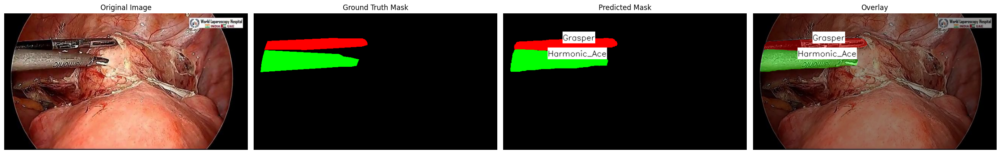

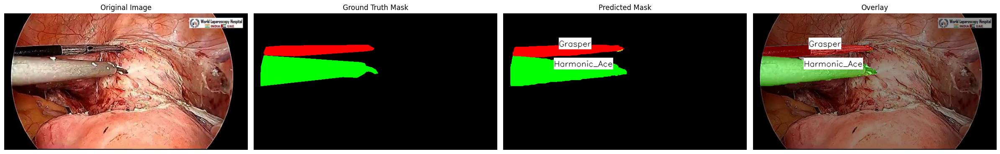

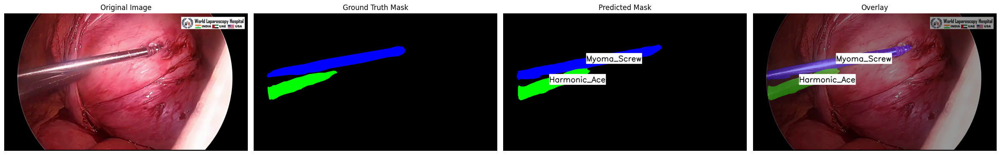

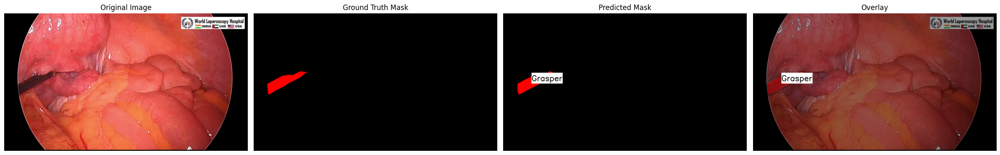

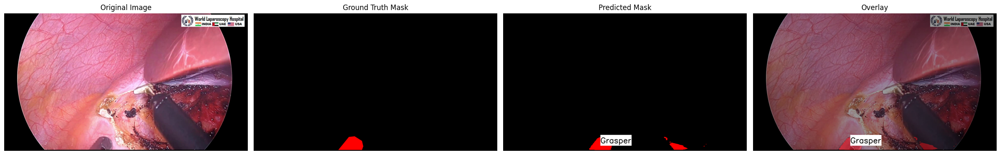

...

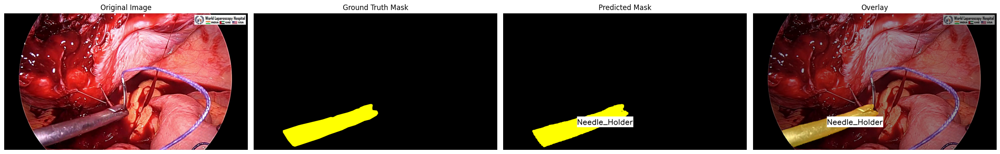

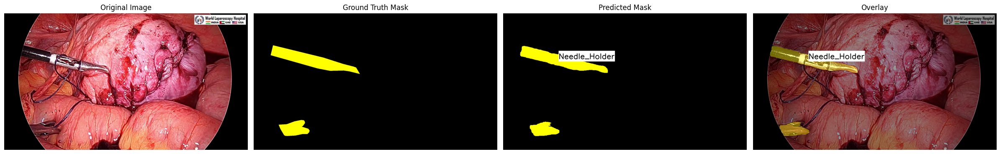

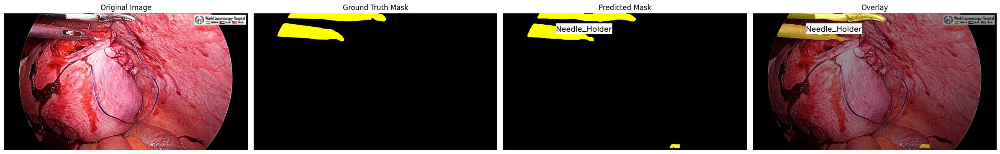

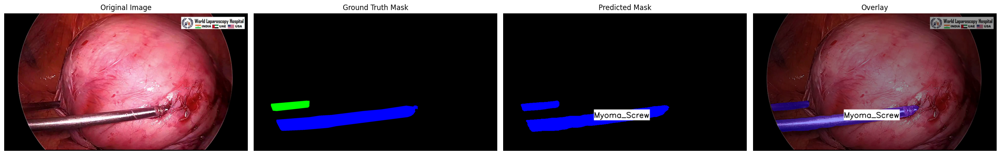

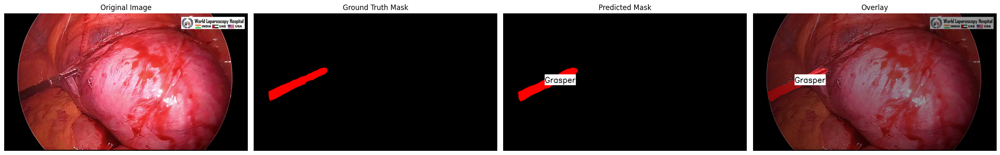

In [ ]:
visualize_predictions(
    model=model,
    device= torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu"),
    images_dir='datasets/surgical_instruments/images/valid',
    masks_dir='datasets/surgical_instruments/semantic_masks/valid',
    num_images= 20
)

In [ ]:
def visualize_predictions_with_boxes(
    model,
    device,
    images_dir,
    masks_dir,
    num_images=5
):
    import random
    from torch.utils.data import DataLoader, Subset
    import torchvision.transforms.functional as TF

    val_transforms = get_validation_augmentations()
    raw_dataset = SemanticSegmentationDataset(images_dir, masks_dir, transform=None)
    transformed_dataset = SemanticSegmentationDataset(images_dir, masks_dir, transform=val_transforms)

    indices = random.sample(range(len(transformed_dataset)), num_images)
    raw_subset = Subset(raw_dataset, indices)
    transformed_subset = Subset(transformed_dataset, indices)

    raw_loader = DataLoader(raw_subset, batch_size=1, shuffle=False)
    transformed_loader = DataLoader(transformed_subset, batch_size=1, shuffle=False)

    model.eval()

    import matplotlib.pyplot as plt
    fig, axes = plt.subplots(num_images, 4, figsize=(24, 4 * num_images))
    if num_images == 1:
        axes = np.expand_dims(axes, axis=0)

    for i, ((raw_img, raw_mask), (input_tensor, _)) in enumerate(zip(raw_loader, transformed_loader)):
        raw_img_np = raw_img.squeeze(0).permute(1, 2, 0).numpy()
        raw_img_np = (raw_img_np * 255).astype(np.uint8)
        orig_size = raw_img_np.shape[:2][::-1]

        input_tensor = input_tensor.to(device)
        with torch.no_grad():
            output = model(input_tensor)
            pred_mask = torch.argmax(output, dim=1).squeeze(0).cpu().numpy()

        gt_mask = raw_mask.squeeze(0).cpu().numpy()

        pred_mask_resized = cv2.resize(pred_mask.astype(np.uint8), orig_size, interpolation=cv2.INTER_NEAREST)
        gt_mask_resized = cv2.resize(gt_mask.astype(np.uint8), orig_size, interpolation=cv2.INTER_NEAREST)

        pred_color = mask_to_color(pred_mask_resized)
        gt_color = mask_to_color(gt_mask_resized)
        overlay = cv2.addWeighted(raw_img_np, 0.6, pred_color, 0.4, 0)

        unique_labels = np.unique(pred_mask_resized)
        drawn_labels = set()

        for cls_id in unique_labels:
            if cls_id == 0:
                continue

            binary_mask = (pred_mask_resized == cls_id).astype(np.uint8)
            num_components, component_mask = cv2.connectedComponents(binary_mask)

            for comp_id in range(1, num_components):
                instance_mask = (component_mask == comp_id).astype(np.uint8)
                contours, _ = cv2.findContours(instance_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

                if not contours:
                    continue

                cnt = max(contours, key=cv2.contourArea)
                area = cv2.contourArea(cnt)
                if area < 100:
                    continue

                x, y, w, h = cv2.boundingRect(cnt)
                box_color = class_colors[cls_id]
                cv2.rectangle(pred_color, (x, y), (x + w, y + h), box_color, 2)
                cv2.rectangle(overlay, (x, y), (x + w, y + h), box_color, 2)

                if cls_id not in drawn_labels:
                    M = cv2.moments(cnt)
                    if M["m00"] != 0:
                        cX = int(M["m10"] / M["m00"])
                        cY = int(M["m01"] / M["m00"])
                        pos = (cX - 10, cY - 10)

                        label = class_names[cls_id]
                        font = cv2.FONT_HERSHEY_SIMPLEX
                        height, width, _ = overlay.shape
                        font_scale = 2 if width > 800 else 0.7
                        thickness = 3 if width > 800 else 1

                        (text_w, text_h), baseline = cv2.getTextSize(label, font, font_scale, thickness)
                        cv2.rectangle(pred_color, (pos[0], pos[1] - text_h - baseline), (pos[0] + text_w, pos[1] + baseline), (255, 255, 255), cv2.FILLED)
                        cv2.rectangle(overlay, (pos[0], pos[1] - text_h - baseline), (pos[0] + text_w, pos[1] + baseline), (255, 255, 255), cv2.FILLED)
                        cv2.putText(pred_color, label, pos, font, font_scale, (0, 0, 0), thickness, cv2.LINE_AA)
                        cv2.putText(overlay, label, pos, font, font_scale, (0, 0, 0), thickness, cv2.LINE_AA)

                        drawn_labels.add(cls_id)

        # Draw row of 4 images
        axes[i, 0].imshow(raw_img_np)
        axes[i, 0].set_title("Original Image")
        axes[i, 0].axis('off')

        axes[i, 1].imshow(gt_color)
        axes[i, 1].set_title("Ground Truth Mask")
        axes[i, 1].axis('off')

        axes[i, 2].imshow(pred_color)
        axes[i, 2].set_title("Predicted Mask")
        axes[i, 2].axis('off')

        axes[i, 3].imshow(overlay)
        axes[i, 3].set_title("Overlay")
        axes[i, 3].axis('off')

    plt.tight_layout()
    plt.show()

Loaded 815 images with masks.
Loaded 815 images with masks.


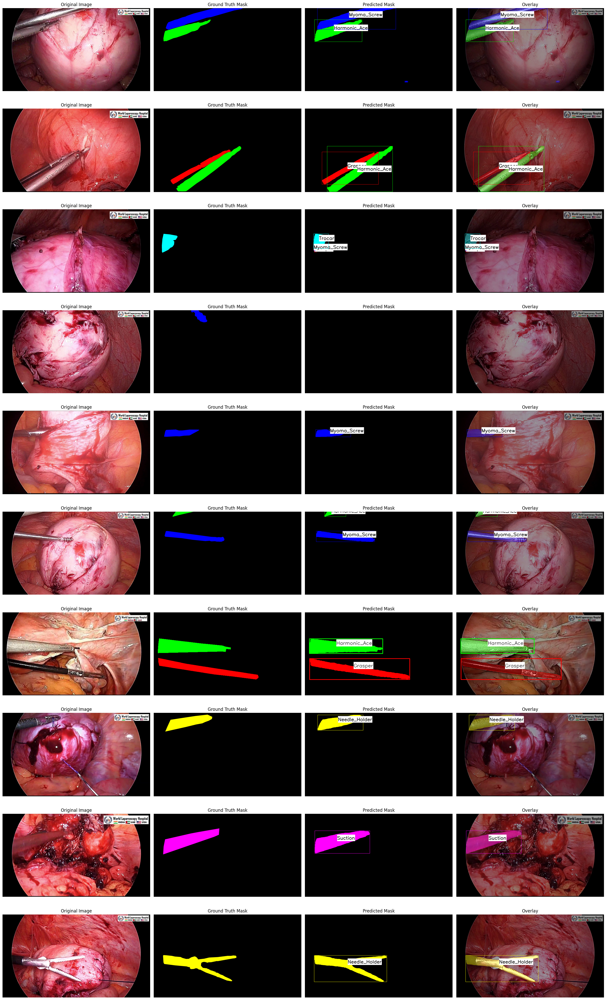

In [ ]:
visualize_predictions_with_boxes(
    model=model,
    device= torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu"),
    images_dir='datasets/surgical_instruments/images/valid',
    masks_dir='datasets/surgical_instruments/semantic_masks/valid',
    num_images= 10
)

In [34]:
def visualize_predictions_with_boxes_bg(
    model,
    device,
    images_dir,
    masks_dir,
    num_images=5
):
    import random
    from torch.utils.data import DataLoader, Subset
    import torchvision.transforms.functional as TF

    val_transforms = get_validation_augmentations()
    raw_dataset = SemanticSegmentationDataset(images_dir, masks_dir, transform=None)
    transformed_dataset = SemanticSegmentationDataset(images_dir, masks_dir, transform=val_transforms)

    indices = random.sample(range(len(transformed_dataset)), num_images)
    raw_subset = Subset(raw_dataset, indices)
    transformed_subset = Subset(transformed_dataset, indices)

    raw_loader = DataLoader(raw_subset, batch_size=1, shuffle=False)
    transformed_loader = DataLoader(transformed_subset, batch_size=1, shuffle=False)

    model.eval()

    import matplotlib.pyplot as plt
    fig, axes = plt.subplots(num_images, 4, figsize=(24, 4 * num_images))
    if num_images == 1:
        axes = np.expand_dims(axes, axis=0)

    for i, ((raw_img, raw_mask), (input_tensor, _)) in enumerate(zip(raw_loader, transformed_loader)):
        raw_img_np = raw_img.squeeze(0).permute(1, 2, 0).numpy()
        raw_img_np = (raw_img_np * 255).astype(np.uint8)
        orig_size = raw_img_np.shape[:2][::-1]

        input_tensor = input_tensor.to(device)
        with torch.no_grad():
            output = model(input_tensor)
            pred_mask = torch.argmax(output, dim=1).squeeze(0).cpu().numpy()

        gt_mask = raw_mask.squeeze(0).cpu().numpy()

        # Resize masks to original image size
        pred_mask_resized = cv2.resize(pred_mask.astype(np.uint8), orig_size, interpolation=cv2.INTER_NEAREST)
        gt_mask_resized = cv2.resize(gt_mask.astype(np.uint8), orig_size, interpolation=cv2.INTER_NEAREST)

        pred_color = mask_to_color(pred_mask_resized)
        gt_color = mask_to_color(gt_mask_resized)

        # --- Background coloring with transparency ---
        bg_color = (0, 128, 128)

        bg_alpha = 0.8  # adjust this: 0 = fully original image, 1 = fully bg_color
        bg_mask = (pred_mask_resized == 0)

        # Generate background color image
        bg_color_img = np.full_like(raw_img_np, bg_color)

        # Blend background color with original image using alpha
        blended_bg = cv2.addWeighted(raw_img_np, 1 - bg_alpha, bg_color_img, bg_alpha, 0)

        # Create overlay (initial full-mask overlay first)
        overlay = cv2.addWeighted(raw_img_np, 0.6, pred_color, 0.4, 0)

        # Now override only background regions with blended_bg
        overlay[bg_mask] = blended_bg[bg_mask]

        # Apply background color also to pred_color if desired
        pred_color[bg_mask] = bg_color

        #overlay = cv2.addWeighted(raw_img_np, 0.6, pred_color, 0.4, 0)

        unique_labels = np.unique(pred_mask_resized)
        drawn_labels = set()

        for cls_id in unique_labels:
            if cls_id == 0:
                continue

            binary_mask = (pred_mask_resized == cls_id).astype(np.uint8)
            num_components, component_mask = cv2.connectedComponents(binary_mask)

            for comp_id in range(1, num_components):
                instance_mask = (component_mask == comp_id).astype(np.uint8)
                contours, _ = cv2.findContours(instance_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

                if not contours:
                    continue

                cnt = max(contours, key=cv2.contourArea)
                area = cv2.contourArea(cnt)
                if area < 100:
                    continue

                x, y, w, h = cv2.boundingRect(cnt)
                box_color = class_colors[cls_id]
                cv2.rectangle(pred_color, (x, y), (x + w, y + h), box_color, 2)
                cv2.rectangle(overlay, (x, y), (x + w, y + h), box_color, 2)

                if cls_id not in drawn_labels:
                    M = cv2.moments(cnt)
                    if M["m00"] != 0:
                        cX = int(M["m10"] / M["m00"])
                        cY = int(M["m01"] / M["m00"])
                        pos = (cX - 10, cY - 10)

                        label = class_names[cls_id]
                        font = cv2.FONT_HERSHEY_SIMPLEX
                        height, width, _ = overlay.shape
                        font_scale = 2 if width > 800 else 0.7
                        thickness = 3 if width > 800 else 1

                        (text_w, text_h), baseline = cv2.getTextSize(label, font, font_scale, thickness)
                        cv2.rectangle(pred_color, (pos[0], pos[1] - text_h - baseline), (pos[0] + text_w, pos[1] + baseline), (255, 255, 255), cv2.FILLED)
                        cv2.rectangle(overlay, (pos[0], pos[1] - text_h - baseline), (pos[0] + text_w, pos[1] + baseline), (255, 255, 255), cv2.FILLED)
                        cv2.putText(pred_color, label, pos, font, font_scale, (0, 0, 0), thickness, cv2.LINE_AA)
                        cv2.putText(overlay, label, pos, font, font_scale, (0, 0, 0), thickness, cv2.LINE_AA)

                        drawn_labels.add(cls_id)

        # Draw row of 4 images
        axes[i, 0].imshow(raw_img_np)
        axes[i, 0].set_title("Original Image")
        axes[i, 0].axis('off')

        axes[i, 1].imshow(gt_color)
        axes[i, 1].set_title("Ground Truth Mask")
        axes[i, 1].axis('off')

        axes[i, 2].imshow(pred_color)
        axes[i, 2].set_title("Predicted Mask")
        axes[i, 2].axis('off')

        axes[i, 3].imshow(overlay)
        axes[i, 3].set_title("Overlay")
        axes[i, 3].axis('off')

    plt.tight_layout()
    plt.show()

Loaded 815 images with masks.
Loaded 815 images with masks.


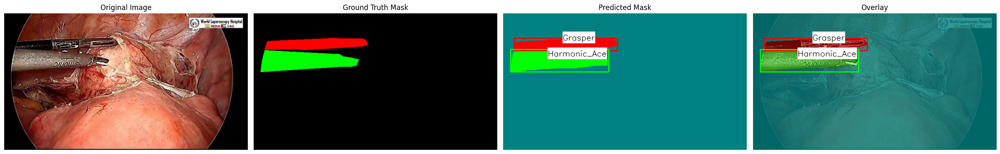

In [46]:
visualize_predictions_with_boxes_bg(
    model=model,
    device= torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu"),
    images_dir='datasets/surgical_instruments/images/valid',
    masks_dir='datasets/surgical_instruments/semantic_masks/valid',
    num_images= 1
)